In [3]:
import tensorflow as tf
from keras.datasets import mnist 
from keras.layers import Dense, Dropout, Input
from keras.models import Model, Sequential 
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam
from tqdm import tqdm 
import numpy as np 
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
def load_data():
    (x_train, y_train), (_,_) = mnist.load_data()
    x_train = (x_train.astype(np.float32) - 127.5) / 127.5
    #convert shape from (60000, 28, 28) to (60000, 784)
    x_train = x_train.reshape(60000,784)
    return x_train, y_train 

x_train, y_train = load_data()
print(x_train.shape, y_train.shape)

11493376/11490434 [==============================] - 27s 2us/step
(60000, 784) (60000,)


In [6]:
##build generator 全链接层
def build_generator():
    model = Sequential()
    model.add(Dense(units=256, input_dim=100))
    model.add(LeakyReLU(alpha=0.2))
    
    model.add(Dense(units=512))
    model.add(LeakyReLU(alpha=0.2))
    
    model.add(Dense(units=1024))
    model.add(LeakyReLU(alpha=0.2))
    
    model.add(Dense(units=784, activation='tanh')) #last layer 产生大小为784的noise
    
    model.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5))
    return model
generator=build_generator()
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 1024)              0         
_________________________________________________________________
dense_4 (Dense)              (None, 784)              

In [7]:
## build discriminator
def build_discriminator():
    model=Sequential()
    
    model.add(Dense(units=1024, input_dim=784)) #input dim corresponds to the dim of image（784）
    model.add(Dropout(0.3))#防止过拟合
    
    model.add(Dense(units=512))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.3))
    
    model.add(Dense(units=256))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.3))
    
    model.add(Dense(units=1, activation='sigmoid'))
    
    model.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5))
    return model 
discriminator = build_discriminator()
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 1024)              803840    
_________________________________________________________________
dropout_1 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_6 (Dense)              (None, 512)               524800    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 256)               131328    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 256)              

In [15]:
##build GAN 
def build_GAN(discriminator, generator):
    discriminator.trainable = False # freeze the variables in discriminator
    GAN_input = Input(shape=(100,)) #instantiate a Keras tensor, expects a 100-dimentional vector, has no value in it, it is only a 框架
    x = generator(GAN_input) #put the generated noise in this 框架
    GAN_output = discriminator(x) #use the discrinimator to get a result
    GAN = Model(inputs=GAN_input, outputs=GAN_output)
    GAN.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5))
    return GAN
GAN = build_GAN(discriminator, generator)
GAN.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         (None, 100)               0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 784)               1486352   
_________________________________________________________________
sequential_2 (Sequential)    (None, 1)                 1460225   
Total params: 2,946,577
Trainable params: 1,486,352
Non-trainable params: 1,460,225
_________________________________________________________________


In [17]:
#function for drawing the generated image
def draw_images(generator, epoch, examples=25, dim=(5,5), figsize=(10,10)):
    noise = np.random.normal(loc=0, scale=1, size=[examples, 100])#100个array，每个array有25个element
    generated_image = generator.predict(noise)#(25, 784)
    generated_image = generated_image.reshape(25,28,28)#个数，长，宽 
    plt.figure(figsize=figsize)
    for i in range(generated_image.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)#一共5行5列，第i+1张图
        plt.imshow(generated_image[i], interpolation='nearest',  cmap='Greys')
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('Generated_images %d.png' %epoch)
"""
batch size: control the # of samples to work through before the model's internal parameters are updated
epoch: the # of complete training cycle
"""

  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 1


 16%|█▌        | 20/128 [00:11<00:51,  2.11it/s]/Users/yujiaxie/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
  2%|▏         | 2/128 [00:00<00:09, 13.67it/s]

Epoch 2


  2%|▏         | 2/128 [00:00<00:07, 16.32it/s]

Epoch 3


  2%|▏         | 2/128 [00:00<00:07, 16.26it/s]

Epoch 4


  2%|▏         | 2/128 [00:00<00:07, 16.54it/s]

Epoch 5


  2%|▏         | 2/128 [00:00<00:07, 16.53it/s]

Epoch 6


  2%|▏         | 2/128 [00:00<00:07, 16.62it/s]

Epoch 7


  2%|▏         | 2/128 [00:00<00:07, 16.69it/s]

Epoch 8


  2%|▏         | 2/128 [00:00<00:07, 16.45it/s]

Epoch 9


  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 10


100%|██████████| 128/128 [01:07<00:00,  1.91it/s]


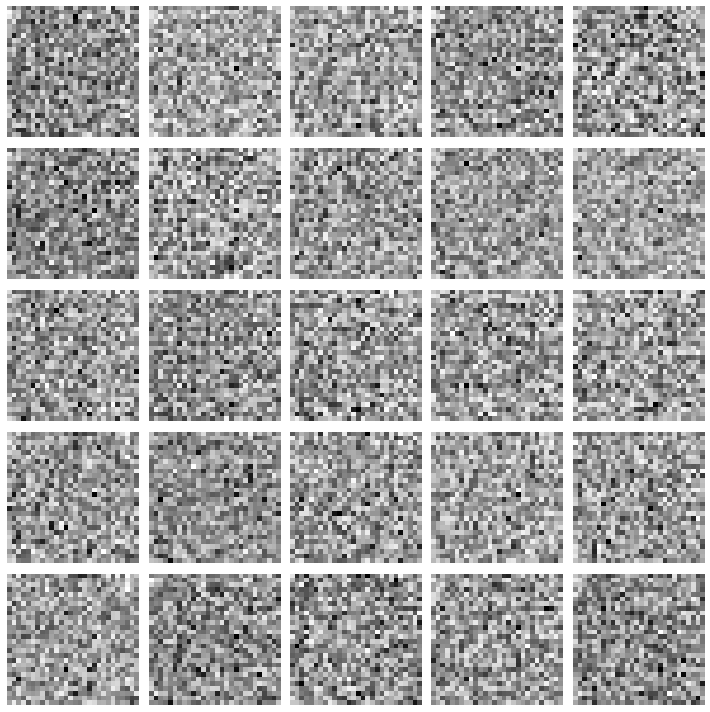

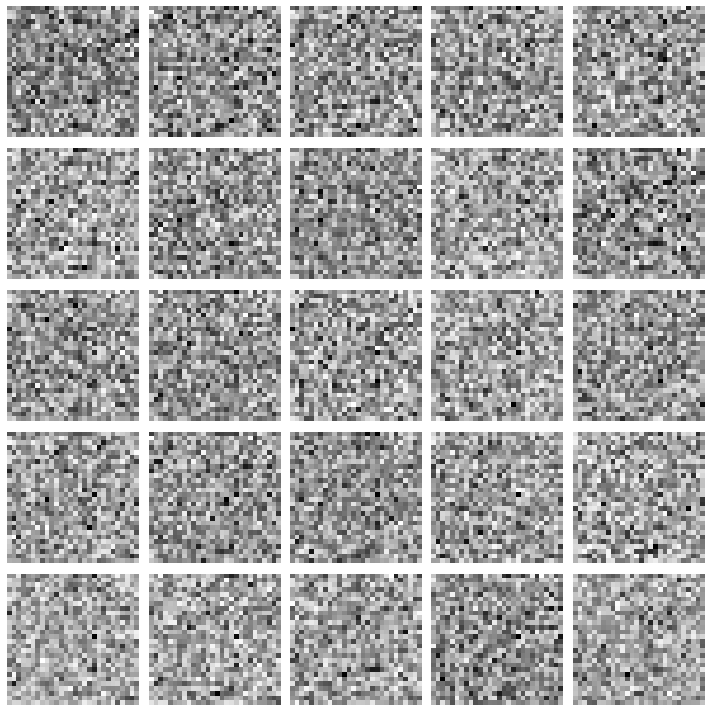

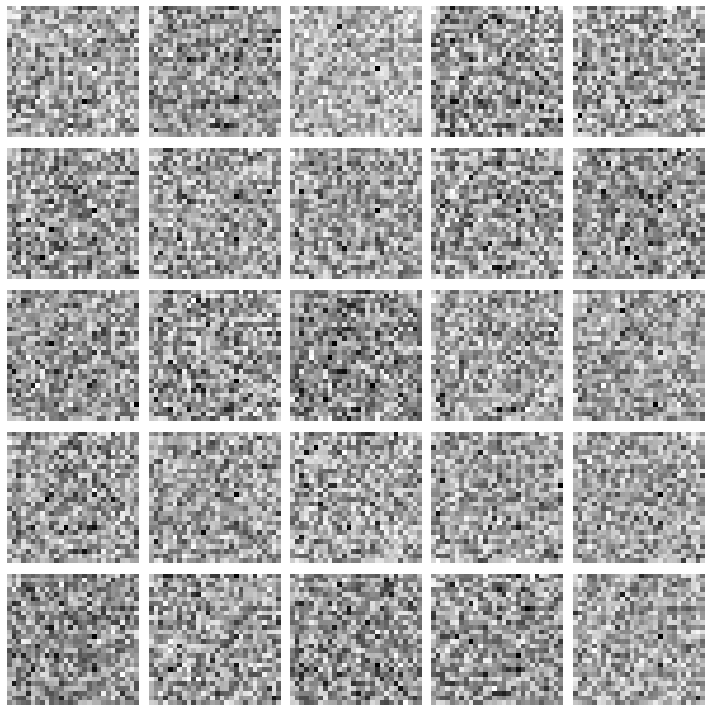

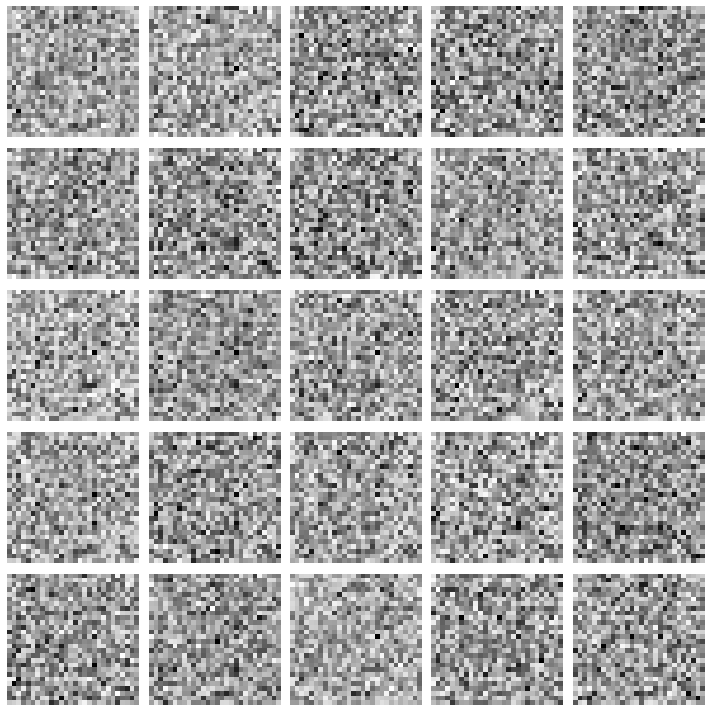

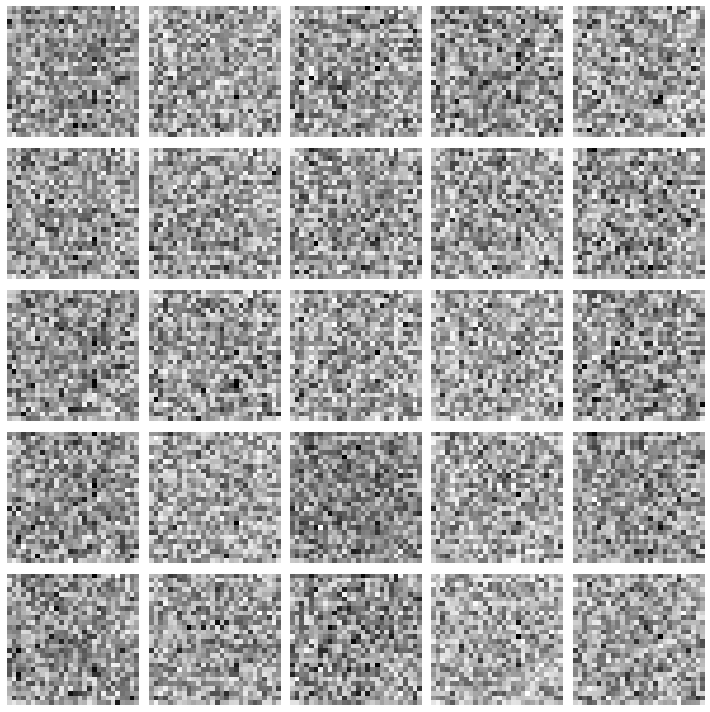

...

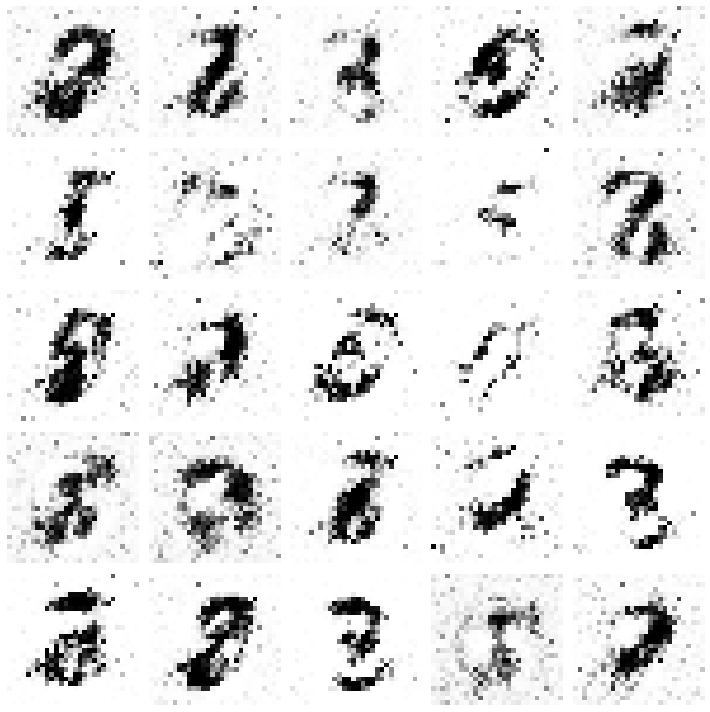

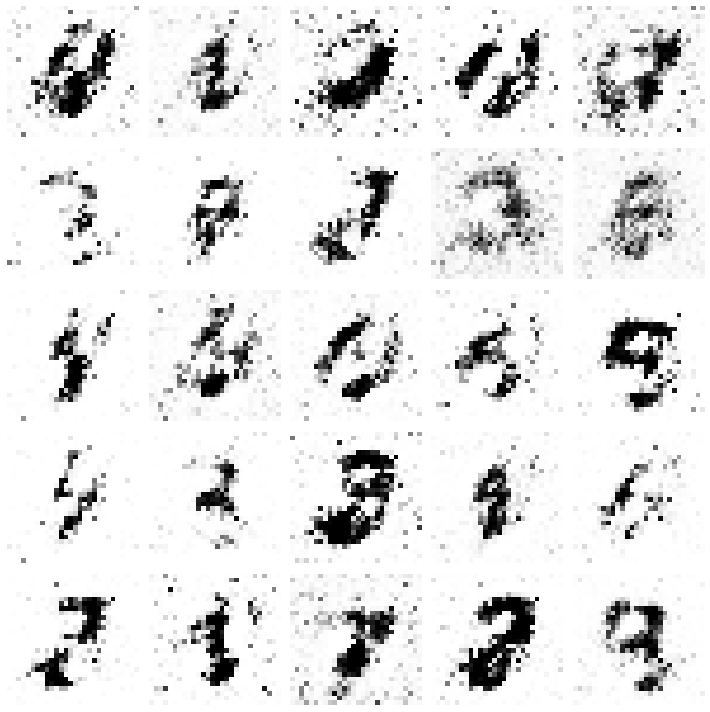

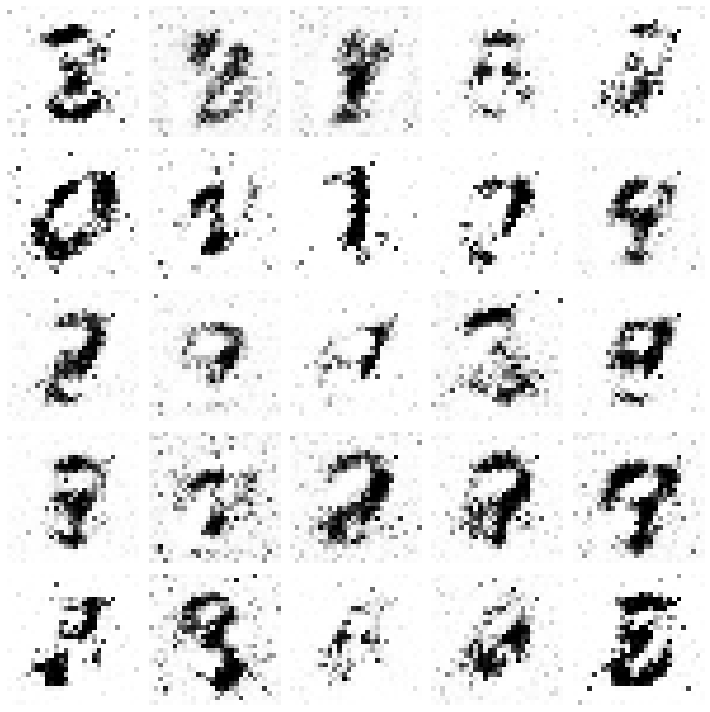

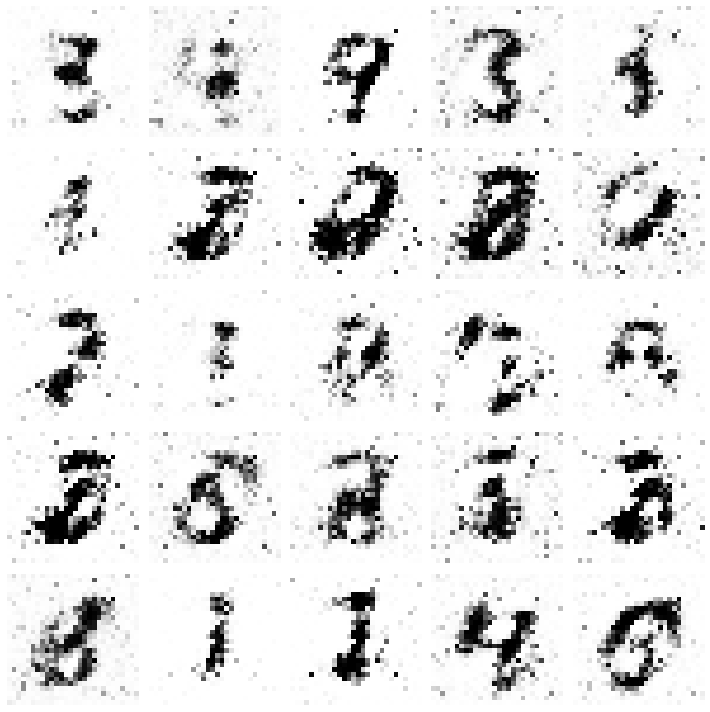

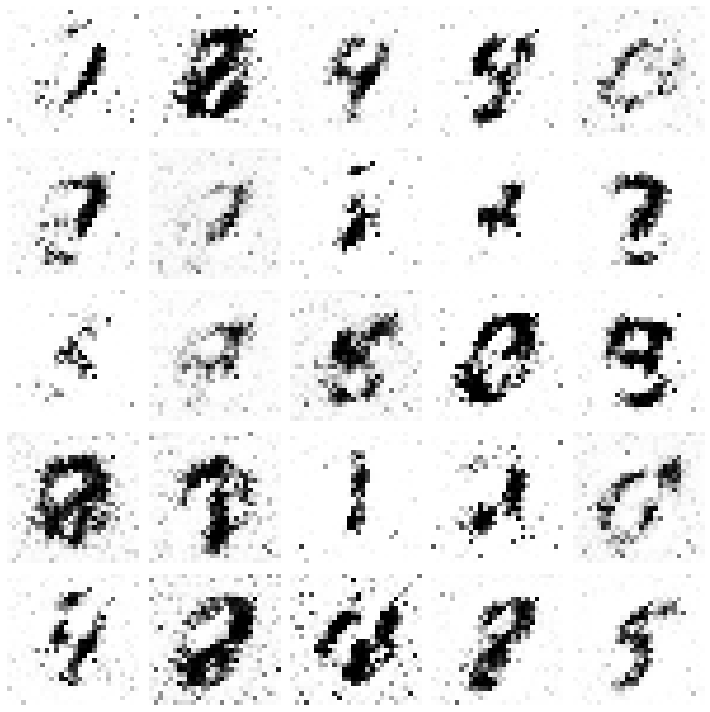

In [19]:
def train_GAN(epochs=1, batch_size=128): 
    #load data
    x_train, y_train = load_data()
    #create GAN
    generator=build_generator()
    discriminator=build_discriminator()
    GAN = build_GAN(discriminator, generator)
    
    for i in range(1, epochs+1):
        print("Epoch %d" %i)
        for _ in tqdm(range(batch_size)):  ## print process, print information for each batch
            #Generate fake images from random noise
            noise = np.random.normal(loc=0, scale=1, size=(batch_size, 100))
            fake_images = generator.predict(noise)
            
            #get the real images
            real_images = x_train[np.random.randint(0, x_train.shape[0], batch_size)] #randomly select 128 images from 0 to 60000
            
            #labels for fake and real images
            fake_labels = np.zeros(batch_size)
            real_labels = np.ones(batch_size)
            
            #concatenate fake and real images
            X = np.concatenate([fake_images, real_images])
            y = np.concatenate([fake_labels, real_labels])
            
            #Train the discriminator
            discriminator.trainable = True
            discriminator.train_on_batch(X, y) # train a single batch only and once
            
            #Train the GAN 
            discriminator.trainable = False 
            GAN.train_on_batch(noise, real_labels)
            
            #Draw generated images every 10 epochs 
            if i ==1 or i%10==0: 
                draw_images(generator, i)
train_GAN(epochs=10, batch_size=128)